In [10]:
import matplotlib.pyplot as plt
%matplotlib inline

from onsets_and_frames.dataset import MAESTRO
# from onsets_and_frames.constants import HOP_LENGTH

## Visualize prediction results

Use debug

In [11]:
import pretty_midi
import soundfile
import torch
import numpy as np
import glob


SAMPLE_RATE = 16000
HOP_LENGTH = SAMPLE_RATE * 32 // 1000
ONSET_LENGTH = SAMPLE_RATE * 32 // 1000
OFFSET_LENGTH = SAMPLE_RATE * 32 // 1000
HOPS_IN_ONSET = ONSET_LENGTH // HOP_LENGTH
HOPS_IN_OFFSET = OFFSET_LENGTH // HOP_LENGTH
MIN_MIDI = 21
MAX_MIDI = 108

N_MELS = 229
MEL_FMIN = 30
MEL_FMAX = SAMPLE_RATE // 2
WINDOW_LENGTH = 2048


In [12]:
def load(audio_path, midi_path):
    """Loads an audio track and the corresponding labels."""
    audio, sr = soundfile.read(audio_path, dtype='int16')
    assert sr == SAMPLE_RATE
    frames_per_sec = sr / HOP_SIZE

    audio = torch.ShortTensor(audio)
    audio_length = len(audio)

    mel_length = audio_length // HOP_SIZE + 1

    midi = pretty_midi.PrettyMIDI(midi_path)
    midi_length_sec = midi.get_end_time()
    frame_length = min(int(midi_length_sec * frames_per_sec), mel_length)

    audio = audio[:frame_length * HOP_SIZE]
    frame = midi.get_piano_roll(fs=frames_per_sec)
    onset = np.zeros_like(frame)
    for inst in midi.instruments:
        for note in inst.notes:
            onset[note.pitch, int(note.start * frames_per_sec)] = 1

    # to shape (time, pitch (88))
    frame = torch.from_numpy(frame[MIN_MIDI:MAX_MIDI + 1].T)
    onset = torch.from_numpy(onset[MIN_MIDI:MAX_MIDI + 1].T)
    data = dict(path=audio_path, audio=audio, frame=frame, onset=onset)
    return data

In [48]:
# Convert midi to wav
from IPython.display import Audio
from pretty_midi import PrettyMIDI

scratch_midi_file = '/home/haemin/Documents/gct634-ai613-2021/hw4/result/pianist8/Yiruma/Yiruma_River_Flows_in_You_finetune_continuation_temp1_5.midi'

scratch_wav = PrettyMIDI(midi_file=scratch_midi_file)

scratch_waveform = scratch_wav.fluidsynth()
Audio(scratch_waveform, rate=44100)


In [13]:
# Load test set of MAESTRO_small
test_dataset = MAESTRO(path='data/MAESTRO_small', groups=['test'], sequence_length=102400)

Loading 1 group of MAESTRO at data/MAESTRO_small


Loading group test: 100%|███████████████████████████████████████████████| 50/50 [00:00<00:00, 283.99it/s]


In [20]:
for i in range(len(test_dataset)):
    data = test_dataset[i]
    print(f'data {i}: {data["path"]}')

data 0: data/MAESTRO/2004/MIDI-Unprocessed_SMF_17_R1_2004_03-06_ORIG_MID--AUDIO_20_R2_2004_12_Track12_wav--1.flac
data 1: data/MAESTRO/2004/MIDI-Unprocessed_XP_04_R1_2004_03-05_ORIG_MID--AUDIO_04_R1_2004_06_Track06_wav.flac
data 2: data/MAESTRO/2006/MIDI-Unprocessed_01_R1_2006_01-09_ORIG_MID--AUDIO_01_R1_2006_02_Track02_wav.flac
data 3: data/MAESTRO/2006/MIDI-Unprocessed_01_R1_2006_01-09_ORIG_MID--AUDIO_01_R1_2006_04_Track04_wav.flac
data 4: data/MAESTRO/2006/MIDI-Unprocessed_03_R1_2006_01-05_ORIG_MID--AUDIO_03_R1_2006_04_Track04_wav.flac
data 5: data/MAESTRO/2006/MIDI-Unprocessed_07_R1_2006_01-04_ORIG_MID--AUDIO_07_R1_2006_04_Track04_wav.flac
data 6: data/MAESTRO/2006/MIDI-Unprocessed_24_R1_2006_01-05_ORIG_MID--AUDIO_24_R1_2006_03_Track03_wav.flac
data 7: data/MAESTRO/2008/MIDI-Unprocessed_04_R1_2008_01-04_ORIG_MID--AUDIO_04_R1_2008_wav--4.flac
data 8: data/MAESTRO/2008/MIDI-Unprocessed_04_R3_2008_01-07_ORIG_MID--AUDIO_04_R3_2008_wav--3.flac
data 9: data/MAESTRO/2008/MIDI-Unprocessed_

In [21]:
data = test_dataset[4]
print(f'data path: {data["path"]}')
print(f'audio_shape: {data["audio"].shape}')
print(f'frame_roll_shape: {data["frame"].shape}')
print(f'onset_roll_shape: {data["onset"].shape}')

data path: data/MAESTRO/2006/MIDI-Unprocessed_03_R1_2006_01-05_ORIG_MID--AUDIO_03_R1_2006_04_Track04_wav.flac
audio_shape: torch.Size([102400])
frame_roll_shape: torch.Size([200, 88])
onset_roll_shape: torch.Size([200, 88])


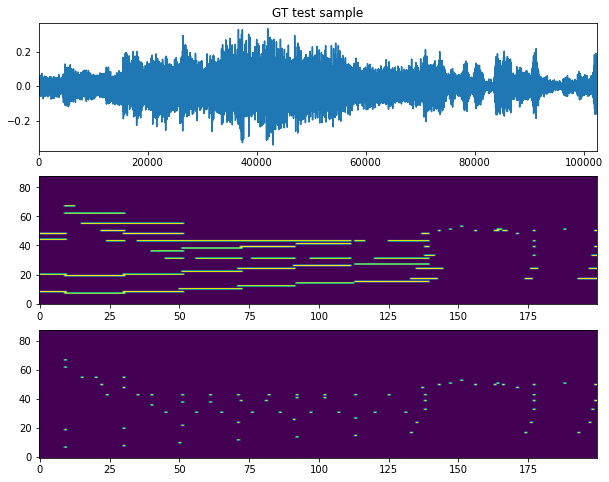

In [22]:
plt.figure(figsize=(10,8))
plt.subplot(311).set_title('GT test sample')
plt.plot(data['audio'].cpu().numpy()[:400*HOP_LENGTH])
plt.autoscale(enable=True, axis='x', tight=True)
plt.subplot(312)
plt.imshow(data['frame'].cpu().numpy()[:400].T, aspect='auto', origin='lower')
plt.subplot(313)
plt.imshow(data['onset'].cpu().numpy()[:400].T, aspect='auto', origin='lower')

## Visualize predicted results

In [23]:
midi_path = '/home/haemin/Documents/gct634-ai613-2021/onsets-and-frames/runs/standardize_10000/output/'
midi_files = sorted(glob.glob("".join([midi_path, '*.mid'])))

print(len(midi_files))

index = 0
data = load(wav_files[index], midi_files[index])
print(wav_files[index])
print(midi_files[index])

50


torch.Size([1508864])


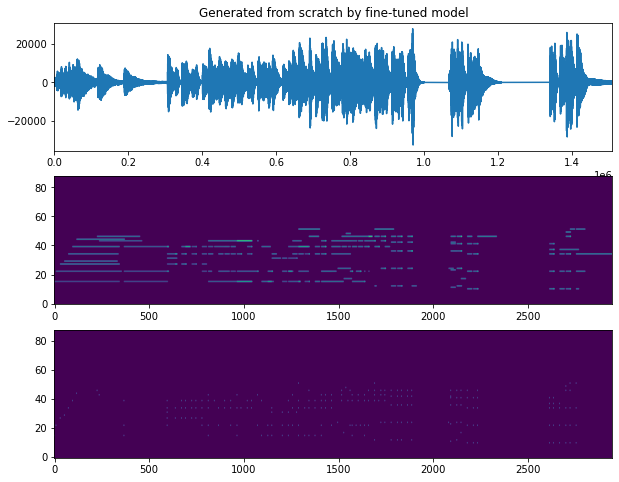

In [99]:
vis_range = 8000
plt.figure(figsize=(10,8))
plt.subplot(311).set_title('Generated from scratch by fine-tuned model')
print(data['audio'].shape)
plt.plot(data['audio'].numpy()[:vis_range*HOP_SIZE])
plt.autoscale(enable=True, axis='x', tight=True)
plt.subplot(312)
plt.imshow(data['frame'].numpy()[:vis_range].T, aspect='auto', origin='lower')
plt.subplot(313)
plt.imshow(data['onset'].numpy()[:vis_range].T, aspect='auto', origin='lower')

Audio(data['audio'].numpy()[:vis_range*HOP_SIZE], rate=SAMPLE_RATE)